In [31]:
%pip install pandas
%pip install matplotlib

Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.
Defaulting to user installation because normal site-packages is not writeable
Note: you may need to restart the kernel to use updated packages.


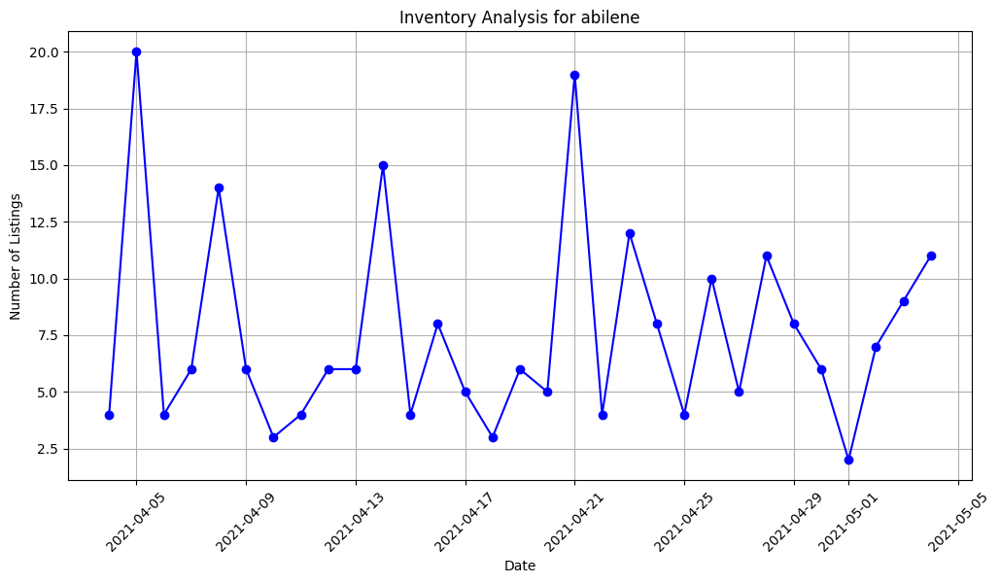

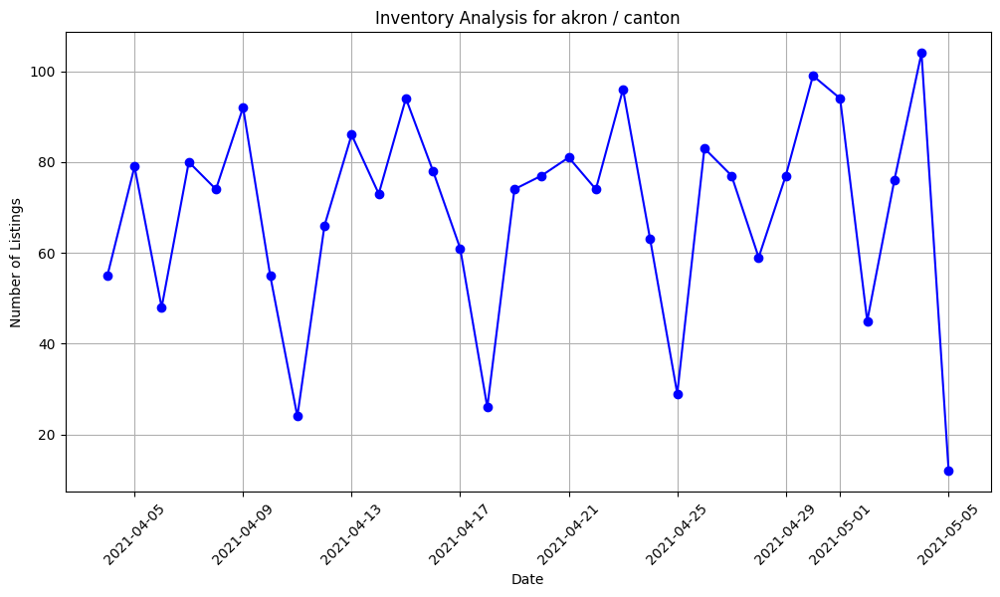

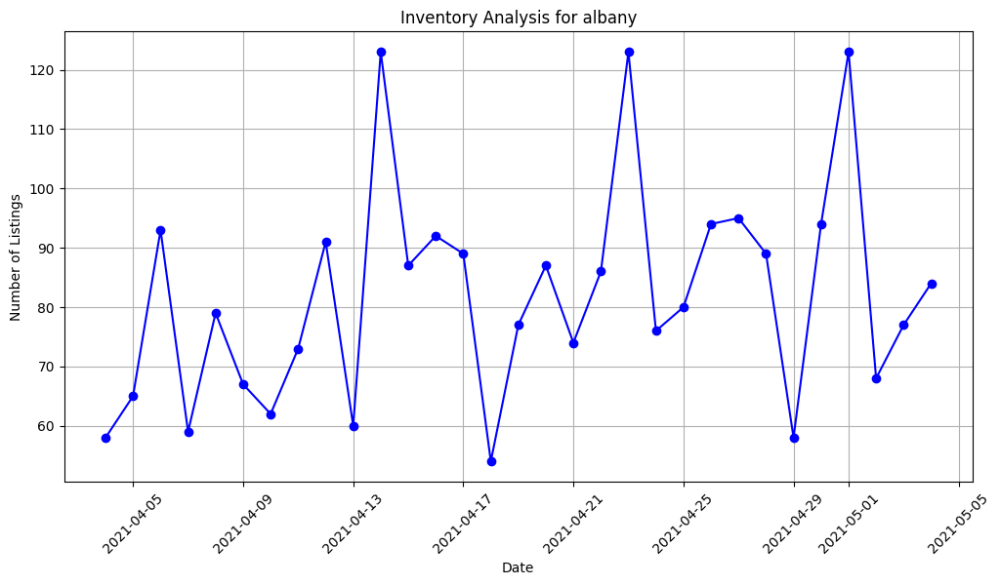

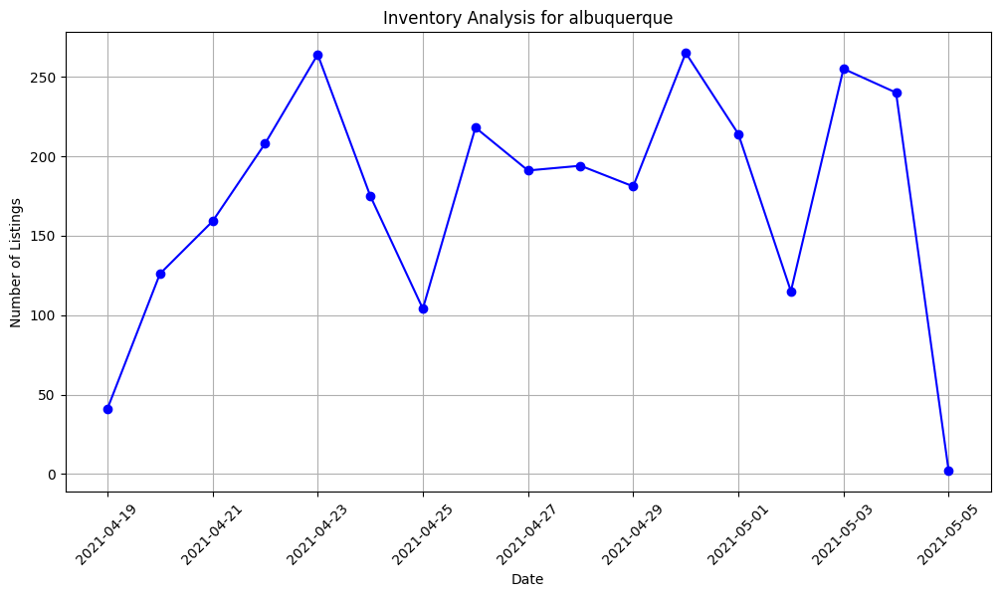

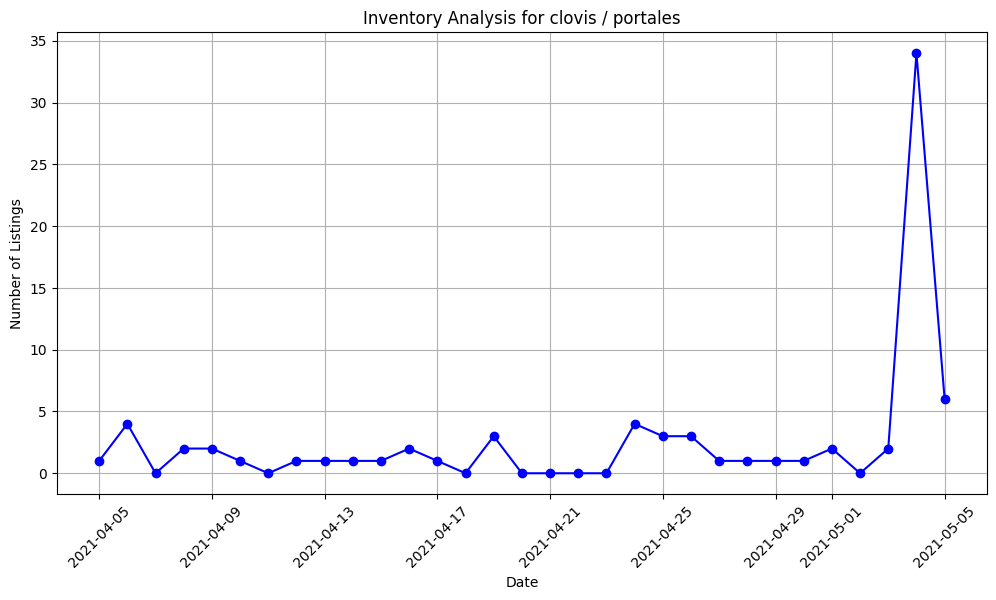

...

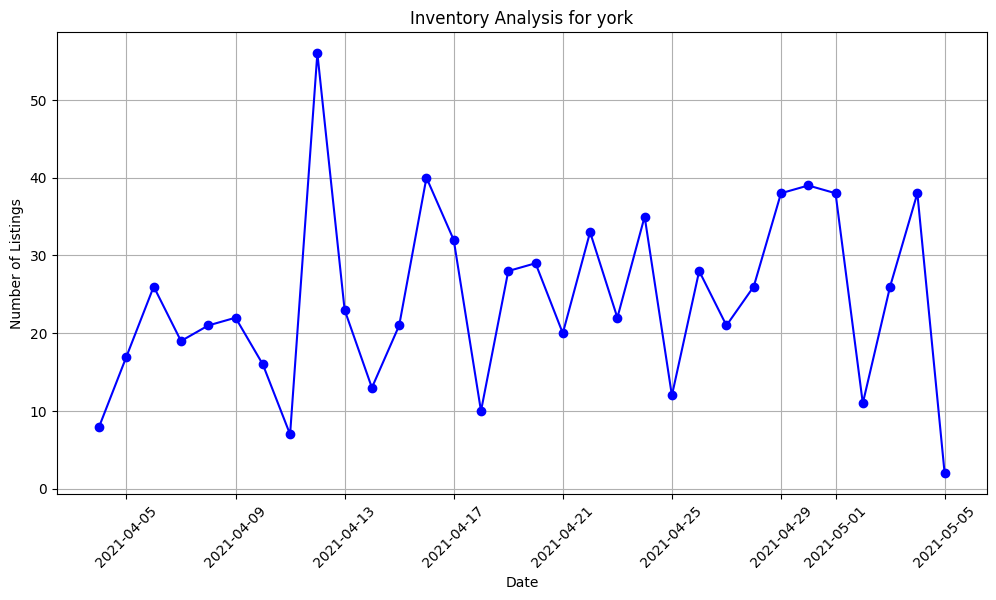

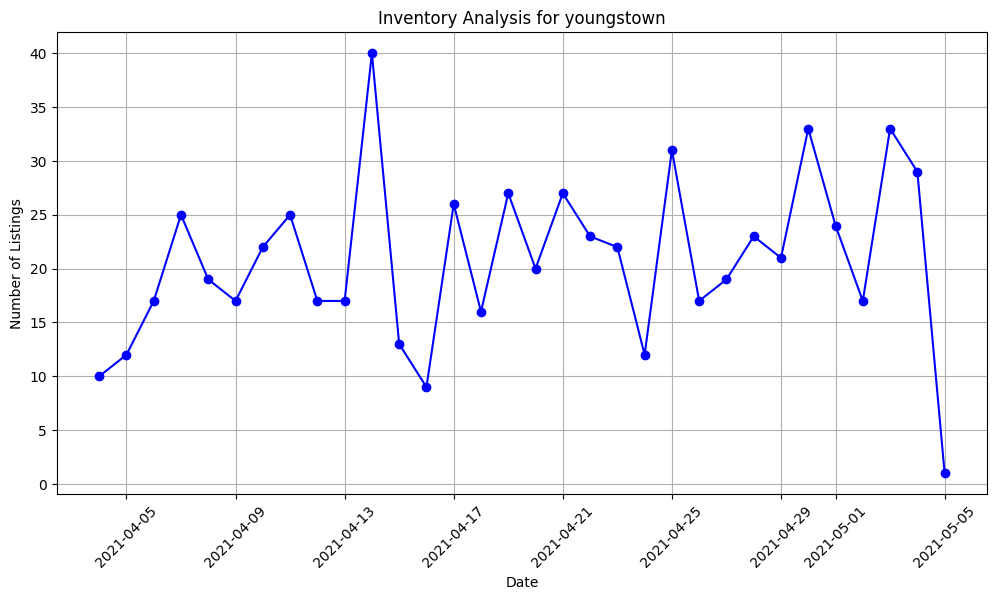

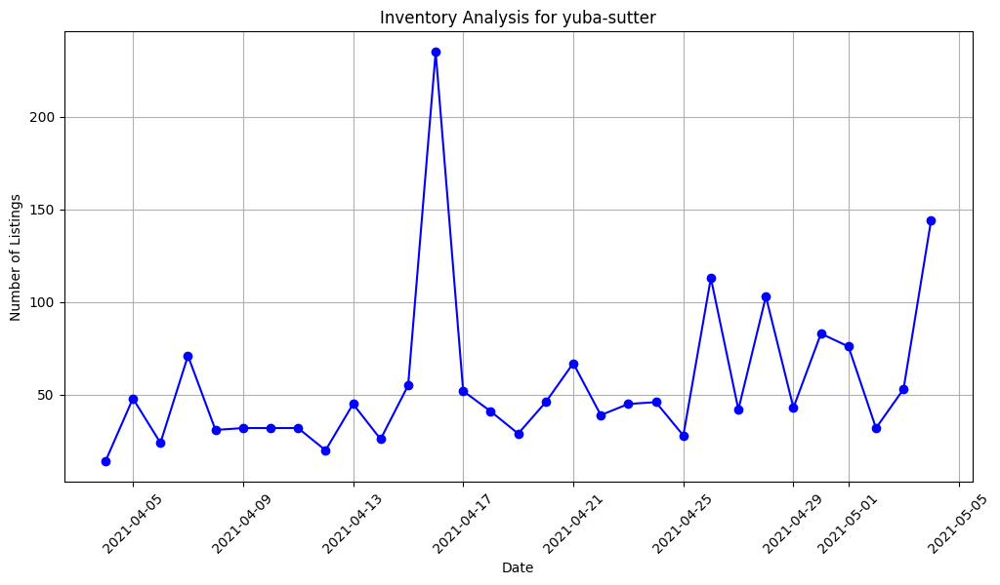

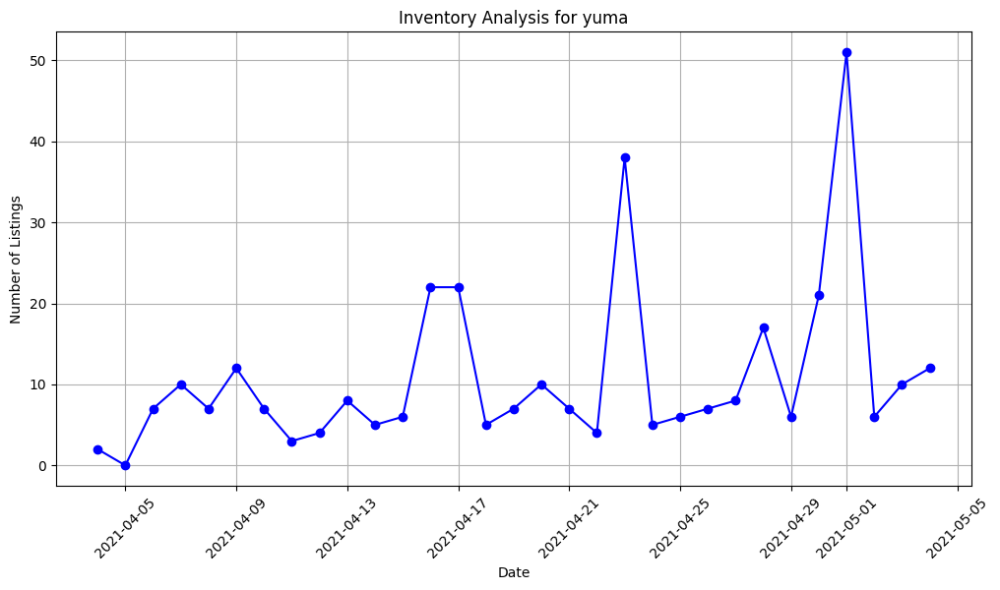

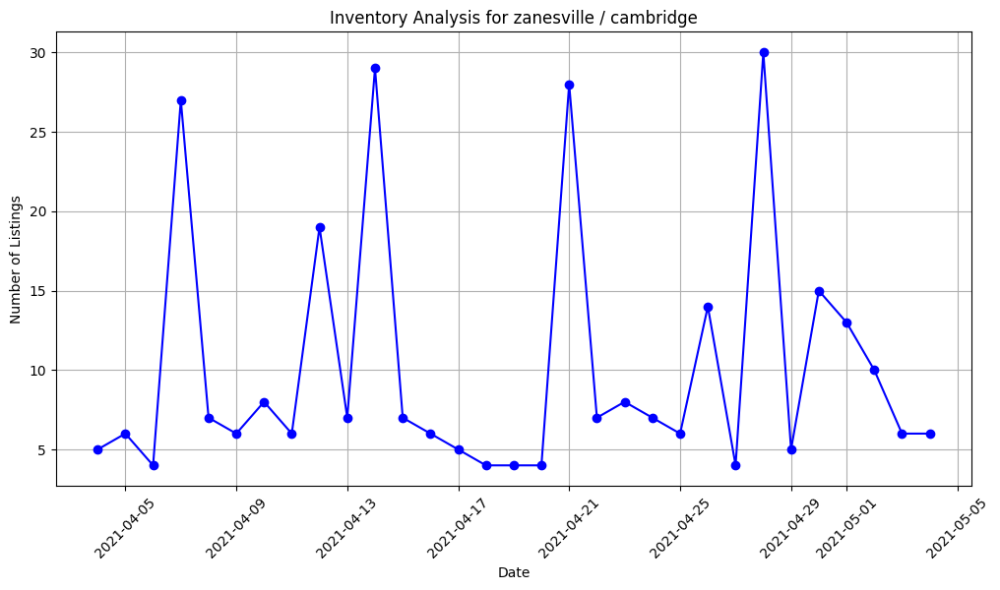

In [32]:
import pandas as pd
import matplotlib.pyplot as plt
import calendar
import time

df = pd.read_csv('craigslist_vehicles.csv')
current_GMT = time.gmtime()

df['posting_date'] = pd.to_datetime(df['posting_date'])

df.set_index('posting_date', inplace=True)

def plot_time_series(data, title, xlabel, ylabel, region=None):
    plt.figure(figsize=(12, 6))
    plt.plot(data, color='blue', marker='o', linestyle='-')
    plt.title(title)
    plt.xlabel(xlabel)
    plt.xticks(rotation=45)
    plt.ylabel(ylabel)
    plt.grid(True)
    plt.savefig('figures/craig_' + region.replace('/', '-') + '.png')
    plt.show()

# Filter data by region and vehicle type
def analyze_region_vehicle(region=None, vehicle_type=None):
    if region and vehicle_type:
        region_vehicle_data = df[(df['region'] == region) & (df['type'] == vehicle_type)]
        title = f'Inventory Analysis for {vehicle_type} in {region}'
    elif region:
        region_vehicle_data = df[df['region'] == region]
        title = f'Inventory Analysis for All Vehicle Types in {region}'
    elif vehicle_type:
        region_vehicle_data = df[df['type'] == vehicle_type]
        title = f'Inventory Analysis for {vehicle_type} in All Regions'
    else:
        regions = df['region'].unique()
        for region in regions:
            region_data = df[df['region'] == region]
            
            daily_counts = region_data.resample('D').size()
            
            plot_time_series(daily_counts, f'Inventory Analysis for {region}', 'Date', 'Number of Listings', region)
            
        return
    
    daily_counts = region_vehicle_data.resample('D').size()
    plot_time_series(daily_counts, title, 'Date', 'Number of Listings')

region_input = input("Enter the region you want to analyze (leave blank for all regions): ").strip()
vehicle_type_input = input("Enter the vehicle type you want to analyze (leave blank for all types): ").strip()

analyze_region_vehicle(region_input, vehicle_type_input)